<a href="https://colab.research.google.com/github/sarahonar/APPLIED-MACHINE-LEARNING/blob/main/Getting_Started_MABe_Challenge_2022_Fruit_Flies_Round_1_v_0_2_2kb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

![Problem Statement](https://images.aicrowd.com/uploads/ckeditor/pictures/711/content_embedding_problem_statement.png)



<p align="center"> Join the communty! <br><a href="https://discord.gg/GTckBMx"><img src="https://img.shields.io/discord/657211973435392011?style=for-the-badge" alt="chat on Discord"></a>
</p>

# How to use this notebook 📝

1. **Copy the notebook**. This is a shared template and any edits you make here will not be saved. _You should copy it into your own drive folder._ For this, click the "File" menu (top-left), then "Save a Copy in Drive". You can edit your copy however you like.
2. **Link it to your AIcrowd account**. In order to submit your predictions to AIcrowd, you need to provide your account's API key.



# Setup AIcrowd Utilities 🛠

In [ ]:
!pip install -U aicrowd-cli
%load_ext aicrowd.magic


## Login to AIcrowd ㊗¶


In [ ]:
%aicrowd login

Please login here: https://api.aicrowd.com/auth/4SewyWsHZVrcaw23TTHpIIFtaTWzBwZHugj8qnLmq4A
API Key valid
Gitlab access token valid
Saved details successfully!


# Install packages 🗃

Please add all pacakages installations in this section

In [ ]:
!pip install scikit-learn

# Import necessary modules and packages 📚


In [ ]:
import os

import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Download the dataset 📲


In [ ]:
aicrowd_challenge_name = "mabe-2022-fruit-fly-groups"
if not os.path.exists('data'):
  os.mkdir('data')

# %aicrowd ds dl -c {aicrowd_challenge_name} -o data # Download all files
# %aicrowd ds dl -c {aicrowd_challenge_name} -o data *submission_data* # download only the submission keypoint data
%aicrowd ds dl -c {aicrowd_challenge_name} -o data *user_train* # download only the submission keypoint data

user_train.npy:   0%|          | 0.00/4.07G [00:00<?, ?B/s]

# Load Data




In [ ]:
user_train = np.load('data/user_train.npy',allow_pickle=True).item()

# sample_submission = np.load('data/sample_submission.npy',allow_pickle=True).item()

## Dataset Specifications 💾

We provide frame-by-frame animal pose estimates extracted from top-view videos of 9-11 interacting flies filmed at 150Hz; raw videos will not be provided. Flies come from a variety of genetically engineered lines, and exhibit both naturally occurring and optogenetically or thermogenetically evoked behaviors.

The following files are available in the `resources` section. A "sequence" is a continuous recording of social interactions between animals: sequences are 30 seconds long (4500 frames at 150Hz) in the fly dataset. The `sequence_id` is a random hash to anonymize experiment details. nans indicate missing data. These occur because videos have between 9 and 11 flies. Data are padded with nans to be all the same size.  

- `user_train.npy` - Training set for the task, which follows the following schema :

```
{
    "sequences" : {
        "<sequence_id> : {
            "keypoints" : a ndarray of shape (4500, 11, 24, 2)
            "vocabulary" : a list of strings identifying sample classification tasks 
            "keypoint_vocabulary" : names of the 24 x 2 keypoints, list of pairs of strings
        }
    }
}
```

- `submission_clips.npy` - Test set for the task, which follows the following schema:

```
{
    "<sequence_id> : {
        "keypoints" : a ndarray of shape (4500, 11, 24, 2)
    }
}
```
- sample_submission.npy - Template for a sample submission for this task, follows the following schema :

```
{
    "frame_number_map": 
        {"<sequence_id-1>": (start_frame_index, end_frame_index),
        "<sequence_id-1>": (start_frame_index, end_frame_index),
        ...
        "<sequence_id-n>": (start_frame_index, end_frame_index),
        }
    "<sequence_id-1>" : [
            [0.321, 0.234, 0.186, 0.857, 0.482, 0.185], .....]
            [0.184, 0.583, 0.475], 0.485, 0.275, 0.958], .....]
        ]
}
```

In `sample_submission`, each key in the `frame_number_map` dictionary refers to the unique sequence id of a video in the test set. The item for each key is expected to be an the start and end index for slicing the `embeddings` numpy array to get the corresponding embeddings. The `embeddings` array is a 2D `ndarray` of floats of size `total_frames` by `X` , where `X` is the dimension of your learned embedding (6 in the above example; maximum permitted embedding dimension is **256**), representing the embedded value of each frame in the sequence. `total_frames` is the sum of all the frames of the sequences, the array should be concatenation of all the embeddings of all the clips.


## How does the data look like? 🔍

### Data overview

In [ ]:
print("Dataset keys - ", user_train.keys())
print("Number of train data sequences - ", len(user_train['sequences']))

Dataset keys -  dict_keys(['keypoint_vocabulary', 'vocabulary', 'sequences'])
Number of train data sequences -  426


### Sample overview

In [ ]:
sequence_names = list(user_train["sequences"].keys())
sequence_key = sequence_names[0]
single_sequence = user_train["sequences"][sequence_key]
print("Sequence name - ", sequence_key)
print("Single Sequence shape ", single_sequence['keypoints'].shape)
print(f"Number of elements in {sequence_key} - ", len(single_sequence))

Sequence name -  01FJRKCP4GE1W1DFX51C
Single Sequence shape  (4500, 11, 24, 2)
Number of elements in 01FJRKCP4GE1W1DFX51C -  2


## Data representation

Animal poses are characterized by the tracked locations of body parts on each animal, termed "keypoints." Keypoints are stored in an ndarray with the following properties:

- Dimensions: (`# frames`) × (`animal ID`) × (`body part`) × (`x, y coordinate`).
- Units: millimeters; coordinates are relative to the center of the circular arena (radius 26.689 mm) the flies are contained within. Original image dimensions are **1024 × 1024** pixels (18.8825 pixels / mm) for the fly dataset.

Body parts are ordered: **1) left wing tip, 2) right wing tip, 3) antennae midpoint, 4) right eye, 5) left eye, 6) left front of thorax, 7) right front of thorax, 8) base of thorax, 9) tip of abdomen, 10) right middle femur base, 11) right middle femur-tibia join, 12) left middle femur base, 13) left middle femur-tibia joint, 14) right front leg tip, 15) right middle leg tip, 16) right rear leg tip, 17) left front leg tip, 18) left middle leg tip, 19) left rear leg tip**.

The placement of these keypoints is illustrated below:
![diagram of keypoint locations](https://images.aicrowd.com/uploads/ckeditor/pictures/699/content_keypoint_ids_fly.png)

In addition, **10 other features are included in the keypoints array**, increasing its dimension from 19 × 2 to 24 × 2. These features are: 20) Ellipse-fit center (x and y coordinates), 21) Ellipse-fit orientation (cosine and sine), 22) Ellipse fit axis lengths (major and minor), 23) Area (body, foreground), and 24) Appearance (foreground/background contrast, minimum neighbor distance).
![diagram of pose features](https://images.aicrowd.com/uploads/ckeditor/pictures/700/content_features_fly.png)


# Helper function for visualization 💁

Useful functions for interacting with the fly tracking sequences


Don't forget to run the cell 😉

In [ ]:
import numpy as np
import os
from torch.utils.data import Dataset, DataLoader
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import cm,animation,colors,rc
rc('animation', html='jshtml')
from tqdm import tqdm

# data frame rate
FPS = 150.
# size of the arena the flies are enclosed in
ARENA_RADIUS_MM = 26.689

# hard-code indices of keypoints and skeleton edges
keypointidx = np.arange(18,dtype=int)
skeleton_edges = np.array([
  [ 7,  8],
  [10, 14],
  [11, 12],
  [12, 17],
  [ 7, 11],
  [ 9, 10],
  [ 7,  9],
  [ 5,  7],
  [ 2,  3],
  [ 2,  7],
  [ 5, 18],
  [ 6, 13],
  [ 7, 16],
  [ 7, 15],
  [ 2,  4],
  [ 6,  7],
  [ 7,  0],
  [ 7,  1]
  ])
# keypoints for computing distances between pairs of flies
fidxdist = np.array([2,7,8])

    
"""
d = get_fly_dists(x,tgt=0)
Compute the distance between fly tgt and all other flies. This is defined as the
minimum distance between any pair of the following keypoints:
'antennae','end_notum_x','end_abdomen', hard-coded with fidxdist
at middle frame data.ctrf
Input:
x: ndarray of size maxnflies x nkeypoints x 2 data sample, sequence of data for all flies
tgt: (optional) which fly to compute distances to. Default is 0.
Output:
d: Array of length nflies with the squared distance to the selected target.
"""
def get_fly_dists(x, tgt=0):
  nkpts = len(fidxdist)
  ntgts = x.shape[0]
  ndim = x.shape[2]
  d = np.min(np.sum((x[:,fidxdist,:].reshape(ntgts,1,nkpts,ndim)-
                     x[tgt,fidxdist,:].reshape(1,nkpts,1,ndim))**2.,axis=3),axis=(1,2))
  return d

    
"""
dark3cm = get_Dark3_cmap()
Returns a new matplotlib colormap based on the Dark2 colormap.
I didn't have quite enough unique colors in Dark2, so I made Dark3 which
is Dark2 followed by all Dark2 colors with the same hue and saturation but
half the brightness.
"""
def get_Dark3_cmap():
  dark2 = list(cm.get_cmap('Dark2').colors)
  dark3 = dark2.copy()
  for c in dark2:
    chsv = colors.rgb_to_hsv(c)
    chsv[2] = chsv[2]/2.
    crgb = colors.hsv_to_rgb(chsv)
    dark3.append(crgb)
  dark3cm = colors.ListedColormap(tuple(dark3))
  return dark3cm

"""
isreal = get_real_flies(x)
Returns which flies in the input ndarray x correspond to real data (are not nan).
Input:
x: ndarray of arbitrary dimensions, as long as the last two dimensions are nfeatures x 2,
and correspond to the keypoints and x,y coordinates.
"""
def get_real_flies(x):
  # x is ntgts x nfeatures x 2
  isreal = np.all(np.isnan(x),axis=(-1,-2))==False
  return isreal

"""
fig,ax,isnewaxis = set_fig_ax(fig=None,ax=None)
Create new figure and/or axes if those are not input.
Returns the handles to those figures and axes.
isnewaxis is whether a new set of axes was created.
"""
def set_fig_ax(fig=None,ax=None):
    isnewaxis = True
    if ax is None:
      if fig is None:
        fig = plt.figure(figsize=(8, 8))
      ax = fig.add_subplot(111)
    else:
      isnewaxis = False
    return fig, ax, isnewaxis

"""
hkpt,hedge,fig,ax = plot_fly(pose=None, 
                             fig=None, ax=None, kptcolors=None, color=None, name=None,
                             plotskel=True, plotkpts=True, hedge=None, hkpt=None)
Visualize the single fly position specified by pose
Inputs:
pose: Required. nfeatures x 2 ndarray.
kptidx: Optional. 1-dimensional array specifying which keypoints to plot. If None, 
uses keypointidx. Default: None.
skelidx: Optional. nedges x 2 ndarray specifying which keypoints to connect with edges. 
If None, uses skeleton_edges. Default: None.
fig: Optional. Handle to figure to plot in. Only used if ax is not specified. Default = None.
If None, a new figure is created.
ax: Optional. Handle to axes to plot in. Default = None. If None, new axes are created.
kptcolors: Optional. Color scheme for each keypoint. Can be a string defining a matplotlib
colormap (e.g. 'hsv'), a matplotlib colormap, or a single color. If None, it is set to 'hsv'.
Default: None
color: Optional. Color for edges plotted. If None, it is set to [.6,.6,.6]. efault: None.
name: Optional. String defining an identifying label for these plots. Default None.
plotskel: Optional. Whether to plot skeleton edges. Default: True.
plotkpts: Optional. Whether to plot key points. Default: True.
hedge: Optional. Handle of edges to update instead of plot new edges. Default: None.
hkpt: Optional. Handle of keypoints to update instead of plot new key points. Default: None.
"""
def plot_fly(pose=None, kptidx=None, skelidx=None, fig=None, ax=None, kptcolors=None, color=None, name=None,
             plotskel=True, plotkpts=True, hedge=None, hkpt=None):
  # plot_fly(x,fig=None,ax=None,kptcolors=None):
  # x is nfeatures x 2
  assert(pose is not None)
  if kptidx is None:
    kptidx = keypointidx
  if skelidx is None:
    skelidx = skeleton_edges

  isnewaxis = False
  if ((hedge is None) and plotskel) or ((hkpt is None) and plotkpts):
    fig,ax,isnewaxis = set_fig_ax(fig=fig,ax=ax)
  isreal = get_real_flies(pose)
  
  if plotkpts:
    if isreal:
      xc = pose[kptidx,0]
      yc = pose[kptidx,1]
    else:
      xc = []
      yc = []
    if hkpt is None:
      if kptcolors is None:
        kptcolors = 'hsv'
      if (type(kptcolors) == list or type(kptcolors) == np.ndarray) and len(kptcolors) == 3:
        kptname = 'keypoints'
        if name is not None:
          kptname = name + ' ' + kptname
        hkpt = ax.plot(xc,yc,'.',color=kptcolors,label=kptname,zorder=10)[0]
      else:
        if type(kptcolors) == str:
          kptcolors = plt.get_cmap(kptcolors)
        hkpt = ax.scatter(xc,yc,c=np.arange(len(kptidx)),marker='.',cmap=kptcolors,zorder=10)
    else:
      if type(hkpt) == matplotlib.lines.Line2D:
        hkpt.set_data(xc,yc)
      else:
        hkpt.set_offsets(np.column_stack((xc,yc)))
  
  if plotskel:
    nedges = skelidx.shape[0]
    if isreal:
      xc = np.concatenate((pose[skelidx,0],np.zeros((nedges,1))+np.nan),axis=1)
      yc = np.concatenate((pose[skelidx,1],np.zeros((nedges,1))+np.nan),axis=1)
    else:
      xc = np.array([])
      yc = np.array([])
    if hedge is None:
      edgename = 'skeleton'
      if name is not None:
        edgename = name + ' ' + edgename
      if color is None:
        color = [.6,.6,.6]
      hedge = ax.plot(xc.flatten(),yc.flatten(),'-',color=color,label=edgename,zorder=0)[0]
    else:
      hedge.set_data(xc.flatten(),yc.flatten())

  if isnewaxis:
    ax.axis('equal')

  return hkpt,hedge,fig,ax
 
"""
hkpt,hedge,fig,ax = plot_flies(poses=None, kptidx=None, skelidx=None,
                               colors=None,kptcolors=None,hedges=None,hkpts=None,
                               **kwargs)
Visualize all flies for a single frame specified by poses.
Inputs:
poses: Required. nflies x nfeatures x 2 ndarray.
colors: Optional. Color scheme for edges plotted for each fly. Can be a string defining a matplotlib
colormap (e.g. 'hsv'), a matplotlib colormap, or a single color. If None, it is set to the Dark3
colormap I defined in get_Dark3_cmap(). Default: None.
kptcolors: Optional. Color scheme for each keypoint. Can be a string defining a matplotlib
colormap (e.g. 'hsv'), a matplotlib colormap, or a single color. If None, it is set to [0,0,0].
Default: None
hedges: Optional. List of handles of edges, one per fly, to update instead of plot new edges. Default: None.
hkpts: Optional. List of handles of keypoints, one per fly,  to update instead of plot new key points.
Default: None.
Extra arguments: All other arguments will be passed directly to plot_fly.
"""
def plot_flies(poses=None,fig=None,ax=None,colors=None,kptcolors=None,hedges=None,hkpts=None,**kwargs):

  if hedges is None or hkpts is None:
    fig,ax,isnewaxis = set_fig_ax(fig=fig,ax=ax)
  else:
    isnewaxis = False
  if colors is None:
    colors = get_Dark3_cmap()
  if kptcolors is None:
    kptcolors = [0,0,0]
  nflies = poses.shape[0]
  if not (type(colors) == list or type(kptcolors) == np.ndarray):
    if type(colors) == str:
      cmap = cm.get_cmap(colors)
    else:
      cmap = colors
    colors = cmap(np.linspace(0.,1.,nflies))
    
  if hedges is None:
    hedges = [None,]*nflies
  if hkpts is None:
    hkpts = [None,]*nflies
    
  for fly in range(nflies):
    hkpts[fly],hedges[fly],fig,ax = plot_fly(poses[fly,...],fig=fig,ax=ax,color=colors[fly,...],
                                             kptcolors=kptcolors,hedge=hedges[fly],hkpt=hkpts[fly],**kwargs)
  if isnewaxis:
    ax.axis('equal')
  
  return hkpts,hedges,fig,ax

"""
animate_pose_sequence(seq=None, kptidx=None, skelidx=None,
                      start_frame=0,stop_frame=None,skip=1,
                      fig=None,ax=None,savefile=None,
                      **kwargs)
Visualize all flies for the input sequence of frames seq.
Inputs:
seq: Required. seql x nflies x nfeatures x 2 ndarray.
start_frame: Which frame of the sequence to start plotting at. Default: 0.
stop_frame: Which frame of the sequence to end plotting on. Default: None. If None, the
sequence length (seq.shape[0]) is used.
skip: How many frames to skip between plotting. Default: 1.
fig: Optional. Handle to figure to plot in. Only used if ax is not specified. Default = None.
If None, a new figure is created.
ax: Optional. Handle to axes to plot in. Default = None. If None, new axes are created.
savefile: Optional. Name of video file to save animation to. If None, animation is displayed
instead of saved.
Extra arguments: All other arguments will be passed directly to plot_flies.
"""
def animate_pose_sequence(seq=None,start_frame=0,stop_frame=None,skip=1,
                          fig=None,ax=None,
                          annotation_sequence=None,
                          savefile=None,
                          **kwargs):
    
  if stop_frame is None:
    stop_frame = seq.shape[0]
  fig,ax,isnewaxis = set_fig_ax(fig=fig,ax=ax)
  
  isreal = get_real_flies(seq)
  idxreal = np.where(np.any(isreal,axis=0))[0]
  seq = seq[:,idxreal,...]

  # plot the arena wall
  theta = np.linspace(0,2*np.pi,360)
  ax.plot(ARENA_RADIUS_MM*np.cos(theta),ARENA_RADIUS_MM*np.sin(theta),'k-',zorder=-10)
  minv = -ARENA_RADIUS_MM*1.01
  maxv = ARENA_RADIUS_MM*1.01
  
  # first frame
  f = start_frame
  h = {}
  h['kpts'],h['edges'],fig,ax = plot_flies(poses=seq[f,...],fig=fig,ax=ax,**kwargs)
  h['frame'] = plt.text(-ARENA_RADIUS_MM*.99,ARENA_RADIUS_MM*.99,'Frame %d (%.2f s)'%(f,float(f)/FPS),
                        horizontalalignment='left',verticalalignment='top')
  ax.set_xlim(minv,maxv)
  ax.set_ylim(minv,maxv)
  ax.axis('equal')
  ax.axis('off')
  fig.tight_layout(pad=0)
  #ax.margins(0)
  
  def update(f):
    h['kpts'],h['edges'],fig,ax = plot_flies(poses=seq[f,...],
                                             hedges=h['edges'],hkpts=h['kpts'],**kwargs)
    h['frame'].set_text('Frame %d (%.2f s)'%(f,float(f)/FPS))
    return h['edges']+h['kpts']

  ani = animation.FuncAnimation(fig, update, frames=np.arange(start_frame,stop_frame,skip,dtype=int))
  if savefile is not None:
    print('Saving animation to file %s...'%savefile)
    writer = animation.PillowWriter(fps=30)
    ani.save(savefile,writer=writer)
    print('Finished writing.')
  else:
    pass
  return ani


# Visualize the fly movements🎥

Sample visualization for plotting pose gifs.

In [ ]:
savefile=None

seqid = next(iter(user_train['sequences']))
seq = user_train['sequences'][seqid]['keypoints']

# animate frames from the sequence
ani = animate_pose_sequence(seq=seq,
                            savefile=savefile,
                            start_frame=0,stop_frame=None,skip=15)
plt.close()
# prepare and show the animation - this could take a few seconds
ani

# Simple Embedding : Framewise PCA 

Each frame contains tracking of multiple flies, in this simple submission, we'll do Principal component analysis of every frame. These PCA embeddings will be used as our submission. 


## Seeding helper
Its good practice to seed before every run, that way its easily reproduced.

In [ ]:
def seed_everything(seed):
  np.random.seed(seed)
  os.environ['PYTHONHASHSEED'] = str(seed)

seed=42
seed_everything(seed)

## Set embedding parameters
We will embed the local context for each fly in each frame with PCA. Set parameters here about how many flies `nfliesclose` and how many frames `nframesclose` are considered "local", and how many frames to sample `nsampleswant` from our training set for PCA. 

In [ ]:
# parameters for embedding and sampling
ntgtsclose = 2 # select this fly and the next closest fly
nframesclose = 2 # select this and the next frame
nsampleswant = 10000

# sizes of various things
nseq = len(user_train['sequences'])
seqid = next(iter(user_train['sequences']))
seq = user_train['sequences'][seqid]['keypoints']
nframes = seq.shape[0]
ntgts = seq.shape[1]
nfeatures = seq.shape[2]
ndim = seq.shape[3]
dimsperframe = ntgtsclose*nfeatures*ndim
highdim = dimsperframe * nframesclose # how many features will we use for each frame and fly
embed_size = 256//ntgts # number of dimensions per target and frame


## Subsample training data
We have a lot of training data! Sample ~`nsampleswant` fly, frame pairs to learn the PCA embedding. We will do this by sampling every fly, frame pair with probability `nsampleswant / nsamplestotal`. 

In [ ]:
# randomly choose a subset of the data
nsamplestotal = 0
for seqid,v in user_train['sequences'].items():
  seq = v['keypoints']

  # there may be < nflies flies in this sequence, ignore missing flies
  isreal = np.any(get_real_flies(seq),axis=0)
  nsamplestotal = nsamplestotal + np.count_nonzero(isreal)*(nframes-nframesclose+1)

# probability to choose any frame, fly
psample = nsampleswant / nsamplestotal

# sample beforehand so we know how many samples we will actually get
dosample = {}
nsamples = 0
for seqid,v in user_train['sequences'].items():
  seq = v['keypoints']

  # there may be < nflies flies in this sequence, ignore missing flies
  isreal = np.any(get_real_flies(seq),axis=0)
  dosample[seqid] = np.random.rand(nframes-nframesclose+1,np.count_nonzero(isreal))<=psample
  nsamples += np.count_nonzero(dosample[seqid])
print(f'Subsampling {nsamples} frames, flies from a total of {nsamplestotal}')

Subsampling 10089 frames, flies from a total of 18319928


## Compute the local context for a given fly and frame from a sequence
`localcontext` is a function that will extract the closest `nfliesclose-1` to the input `tgt` for `nframesclose` frames starting at the input frame `t`.

In [ ]:
# create a basic feature representation from a sequence
def localcontext(seq,tgt,t,nframesclose,ntgtsclose):

  dimsperframe = ntgtsclose*nfeatures*ndim
  highdim = dimsperframe * nframesclose

  highx = np.zeros(highdim)
  x = seq[t,...]
  # find the ntgtsclose-1 flies closest to this fly
  d = get_fly_dists(x, tgt=tgt)
  order = np.argsort(d)
  order = order[:ntgtsclose]

  # store data for nframesclose frames, startint at t
  for off in range(nframesclose):
    t1 = np.minimum(t+off,nframes-1)
    x = seq[t1,order,...]
    highx[off*dimsperframe:(off+1)*dimsperframe] = seq[t1,order,...].flatten()
  return highx


## Compute high-dimensional representation for a subsample of the training data
Loop through all the training data, and, for selected sample frames and flies, compute our high-dimensional feature representation, consisting of the local context for the selected frames and flies. 

In [ ]:
pca_train = np.zeros((nsamples,highdim))

with tqdm(total=nseq) as pbar:
  samplei = 0
  for seqid,v in user_train['sequences'].items():
    seq = v['keypoints']

    # there may be < nflies flies in this sequence, ignore missing flies
    isreal = np.any(get_real_flies(seq),axis=0)
    seq = seq[:,isreal,...]
    ntgtscurr = seq.shape[1]

    for tgt in range(ntgtscurr):
      for t in range(nframes-nframesclose+1):
        if not dosample[seqid][t,tgt]:
          continue

        pca_train[samplei,:] = localcontext(seq,tgt,t,nframesclose,ntgtsclose)
        samplei += 1
    pbar.update()

100%|██████████| 426/426 [00:08<00:00, 53.07it/s]


## Normalize data
Z-score our data (whiten so that the mean is 0 and standard deviation is 1). Fill in any missing data with 0's, equivalent to filling with the mean value for that feature.

In [ ]:
# z-score to normalize data
scaler = StandardScaler()
scaler.fit(pca_train)
pca_train = scaler.transform(pca_train)
pca_train[np.isnan(pca_train)] = 0 # fill nans with mean

## Compute the principal components
Compute the principal components of our high-dimensional, sampled, normalized data. 

In [ ]:
# pca
pca = PCA(n_components = embed_size)
pca.fit(pca_train)

PCA(n_components=23)

## Project data onto our learned embedding
Define a function that inputs a sequence and outputs this sequence in our learned embedding space. 

In [ ]:
# function to project a sequence onto these pcs
def pcaproject(seq,pca,scaler,nframesclose,ntgtsclose):
  nframes = seq.shape[0]
  ntgts = seq.shape[1]
  nfeatures = seq.shape[2]
  ndim = seq.shape[3]
  dimsperframe = ntgtsclose*nfeatures*ndim
  highdim = dimsperframe * nframesclose
  lowdim = pca.n_components * ntgts
  embedding = np.zeros((nframes,lowdim))
  for t in range(nframes):
    for tgt in range(ntgts):
      highx = localcontext(seq,tgt,t,nframesclose,ntgtsclose)
      highx = scaler.transform(highx.reshape(1,highdim))
      highx[np.isnan(highx)] = 0.
      embedding[t,tgt*pca.n_components:(tgt+1)*pca.n_components] = pca.transform(highx)
  return embedding


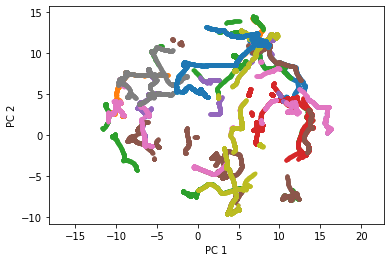

In [ ]:
# apply this embedding to a training sequence
seqid = next(iter(user_train['sequences']))

seq = user_train['sequences'][seqid]['keypoints']
embedding = pcaproject(seq,pca,scaler,nframesclose,ntgtsclose)

# plot different flies different colors
fig,ax = plt.subplots()
for tgt in range(ntgts):
  ax.plot(embedding[:,embed_size*tgt],embedding[:,embed_size*tgt+1],'.')
_ = ax.axis('equal')
_ = ax.set_xlabel('PC 1')
_ = ax.set_ylabel('PC 2')

## Download and load submission data

In [ ]:
#download submission data
%aicrowd ds dl -c {aicrowd_challenge_name} -o data *submission_data* # download only the submission keypoint data

submission_data.npy:   0%|          | 0.00/5.16G [00:00<?, ?B/s]

In [ ]:
# load submission data
#del user_train # may cause RAM shortage otherwise
submission_clips = np.load('data/submission_data.npy',allow_pickle=True).item()

## Test out the embedding on a test example

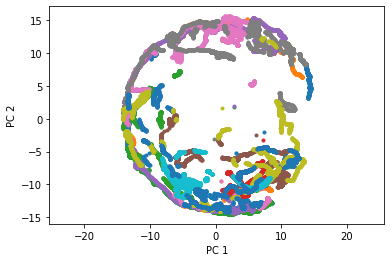

In [ ]:
# apply this embedding to a test sequence
seqid = next(iter(submission_clips['sequences']))
seq = submission_clips['sequences'][seqid]['keypoints']
embedding = pcaproject(seq,pca,scaler,nframesclose,ntgtsclose)

# plot different flies different colors
fig,ax = plt.subplots()
for tgt in range(ntgts):
  ax.plot(embedding[:,embed_size*tgt],embedding[:,embed_size*tgt+1],'.')
_ = ax.axis('equal')
_ = ax.set_xlabel('PC 1')
_ = ax.set_ylabel('PC 2')

## Project all test data onto the learned embedding

In [ ]:
num_total_frames = nframes * len(submission_clips['sequences'])
embeddings_array = np.empty((num_total_frames, embed_size*ntgts), dtype=np.float32)

frame_number_map = {}
start = 0
with tqdm(total=len(submission_clips['sequences'])) as pbar:
  for seqid,v in submission_clips['sequences'].items():
    seq = v['keypoints']
    embedding = pcaproject(seq,pca,scaler,nframesclose,ntgtsclose)
    end = start + nframes
    embeddings_array[start:end,:] = embedding
    frame_number_map[seqid] = (start, end)
    start = end
    pbar.update()
  
assert end == num_total_frames
submission_dict = {"frame_number_map": frame_number_map, "embeddings": embeddings_array}

  3%|▎         | 17/543 [03:19<1:42:52, 11.73s/it]

# Validate the submission ✅
The submssion should follow these constraints:

1.   It should be a dictionary with keys frame_number_map and embeddings
2.   frame_number_map should be have same keys as submission_data
3.   Embeddings is an 2D numpy array of dtype float32 
4.   The embedding size should't exceed 100
5.   The frame number map matches the clip lengths

You can use the helper function below to check these


Stack up all of the training sequences to create the data we'll use to fit our principal axes.

In [ ]:
def validate_submission(submission, submission_clips):
    if not isinstance(submission, dict):
      print("Submission should be dict")
      return False

    if 'frame_number_map' not in submission:
      print("Frame number map missing")
      return False

    if 'embeddings' not in submission:
        print('Embeddings array missing')
        return False
    elif not isinstance(submission['embeddings'], np.ndarray):
        print("Embeddings should be a numpy array")
        return False
    elif not len(submission['embeddings'].shape) == 2:
        print("Embeddings should be 2D array")
        return False
    elif not submission['embeddings'].shape[1] <= 256:
        print("Embeddings too large, max allowed is 256")
        return False
    elif not isinstance(submission['embeddings'][0, 0], np.float32):
        print(f"Embeddings are not float32")
        return False

    
    total_clip_length = 0
    for key in submission_clips['sequences']:
        start, end = submission['frame_number_map'][key]
        clip_length = submission_clips['sequences'][key]['keypoints'].shape[0]
        total_clip_length += clip_length
        if not end-start == clip_length:
            print(f"Frame number map for clip {key} doesn't match clip length")
            return False
            
    if not len(submission['embeddings']) == total_clip_length:
        print(f"Emebddings length doesn't match submission clips total length")
        return False

    
    if not np.isfinite(submission['embeddings']).all():
        print(f"Emebddings contains NaN or infinity")
        return False
    
    print("All checks passed")
    return True

In [ ]:
validate_submission(submission_dict, submission_clips)

All checks passed


True

## Save the prediction as `npy` (Optional) 📨

In [ ]:
# !cp submission.npy /content/drive/MyDrive/mabe/baseline_submission_task1_jun2.npy

In [ ]:
np.save("submission.npy", submission_dict)

## Submit to AIcrowd 🚀

In [ ]:
%aicrowd submission create --description "PCA-Getting-Started" -c {aicrowd_challenge_name} -f submission.npy